# Abstract



This project looks at census data and how it can be used to predict Commute time in the US. Using census data from 2015 and 2017, a table was created that shows the proportion of the population in each county that has a certain aspect. For example, each county has the proportion of citizens that drive themselves, carpool, walk, or take public transportation. The data was cleaned and transformed using principal componenet analysis. Three models were run that were assesed using R-Squared and Mean Squared Error. Techniques such as Grid Search Cross Validation and Principal Component Analysis were implemented to decrease error in the model.

#Overview and Motivation

The American Community Survey (ACS) reports include multiple topics such as social, economic, demographic, and housing. In the dataset acquired from Kaggle, and expanded on using in-class datasets and geolocations, important variables and groups include demographic information, income, poverty levels, citizen work field, commute distances, office type, and unemployment rate. These variables are split by the state and country that the US population is in. Counties can be further divided by their tract ID, which is a combination of their fips id (county id) and subcounty ID.

A regression to predict mean commute time was chosen to assist the local government in planning for infrastructure to accomodate expansion or changes in the demographics of their county. In 2023 when this report was written, calculating mean commute time is also benefitial when companies in the counties are considering making their workforce go back to the office full time to see its impact.

#Related Work

Interest in this topic was driven by the desire to use census data for a data science task. Census data is readily available for many countires and has been long tracked providing an excellent dataset for identifying trends for regressions and classifications. For futher reading on the topic visit the [US Census Website](https://www.census.gov/topics/research/data-science.About.html#list-tab-832261440). The website goes into detail about how data science is currenlty used to analyze census data, how privacy is managed, and research papers written by the Census Bureau.

# Initial Questions

There are two questions that I am going to answer with the regression models:

1) Covid just started, 75% of the private sector moves to work at home. In Worcester County, does the mean commute time reduce by more than 20 min?

2) Maricopa County is the fastest growing county in the US. What effect does a 10% increase in population have on the mean commute time?

#Data

The two datasets that I am going to use are from the Kaggle dataset [US Census Demographic Data](https://www.kaggle.com/datasets/muonneutrino/us-census-demographic-data). The two data sets have the same variables, one for 2015 and one for 2017. Some of the headers are different and need to be adjusted before any merging of the two tables. I also wanted to add the latitude and longitudinal centers for each county using their cfips ID, which is equivalent to the CensusId in the tables.

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statistics as st
%matplotlib inline

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
census_2015 = pd.read_csv('/content/drive/MyDrive/CS539/Project/acs2015_county_data.csv',sep = ',')
census_2017 = pd.read_csv('/content/drive/MyDrive/CS539/Project/acs2017_county_data.csv',sep = ',')
cfips_loc = pd.read_csv('/content/drive/MyDrive/CS539/Project/cfips_location.csv',sep = ',')

#Data Joining and Cleaning

##Joining

The first step is to add the location data for the counties on the 2015 and 2017 sets. This is done using a left-join on the census tables. I picked left join in case there are territories that are included in the cfips.csv that are not in the census tables. The header for CensusId is different for the 2017 table and will be corrected.

In [ ]:
#Left Join for cfips lat and lng
df_2015 = census_2015.merge(cfips_loc,how = 'left', left_on = ['CensusId'],
                                right_on = ['cfips'], suffixes = [None,''])

df_2017 = census_2017.merge(cfips_loc,how = 'left', left_on = ['CountyId'],
                                right_on = ['cfips'], suffixes = [None,''])

In [ ]:
#drop rows from cfips.csv that are not needed
df_2015.drop(['name','cfips'],axis = 1, inplace = True)
df_2017.drop(['name','cfips'],axis = 1, inplace = True)

In [ ]:
df_2015.head()

,CensusId,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,...,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,lng,lat
0,1001,Alabama,Autauga,55221,26745,28476,2.6,75.8,18.5,0.4,...,1.8,26.5,23986,73.6,20.9,5.5,0.0,7.6,-86.642900,32.535142
1,1003,Alabama,Baldwin,195121,95314,99807,4.5,83.1,9.5,0.6,...,3.9,26.4,85953,81.5,12.3,5.8,0.4,7.5,-87.722745,30.727825
2,1005,Alabama,Barbour,26932,14497,12435,4.6,46.2,46.7,0.2,...,1.6,24.1,8597,71.8,20.8,7.3,0.1,17.6,-85.391068,31.870090
3,1007,Alabama,Bibb,22604,12073,10531,2.2,74.5,21.4,0.4,...,0.7,28.8,8294,76.8,16.1,6.7,0.4,8.3,-87.126814,32.998376
4,1009,Alabama,Blount,57710,28512,29198,8.6,87.9,1.5,0.3,...,2.3,34.9,22189,82.0,13.5,4.2,0.4,7.7,-86.567006,33.980871


In [ ]:
#Force CensusId to string and fix mismatch labels
df_2015['CensusId'] = df_2015['CensusId'].astype(str)
df_2015.rename(columns = {'Citizen': 'VotingAgeCitizen'}, inplace = True)

df_2017.rename(columns = {'CountyId': 'CensusId'}, inplace = True)
df_2017['CensusId'] = df_2017['CensusId'].astype(str)

Some Census IDs have a leading zero that is not included in the raw data. To add the zero i force the ID to be a string and add '0' to the front of the IDs by state that need it.

In [ ]:
#Add Leading Zero to CensusId
zero_states = ['Connecticut','Alabama','Arkansas','Colorado','California','Arizona','Alaska']
for index, row in df_2015.iterrows():
    if row['State'] in zero_states:
      df_2015.at[index,'CensusId'] = '0'+row['CensusId']

for index, row in df_2017.iterrows():
    if row['State'] in zero_states:
      df_2017.at[index,'CensusId'] = '0'+row['CensusId']

## Cleaning

Now that the dataframes are joined, next is to adjust for errors and missing values.

In [ ]:
print('2015 NAN: ' + str(df_2015.isna().sum().sum()))
print('2017 NAN: ' + str(df_2017.isna().sum().sum()))

2015 NAN: 7
2017 NAN: 5


In [ ]:
#Explore erros in 2015
errors = df_2015.columns[df_2015.isna().any()].tolist()
errors

['Income', 'IncomeErr', 'ChildPoverty', 'lng', 'lat']

In [ ]:
errors.extend(['State','County'])
error_df = df_2015[errors]
error_df[error_df['lng'].isna()].head()

,Income,IncomeErr,ChildPoverty,lng,lat,State,County
81,38229.0,1809.0,39.7,NaN,NaN,Alaska,Kusilvak Census Area
2412,26369.0,1616.0,61.5,NaN,NaN,South Dakota,Oglala Lakota


Two counties did not have geograohical location in cfips.csv. That can be manually added by searching for the location online.

In [ ]:
error_df[error_df['ChildPoverty'].isna()].head()

,Income,IncomeErr,ChildPoverty,lng,lat,State,County
548,66250.0,9909.0,NaN,-156.949374,21.172957,Hawaii,Kalawao


Kalawao Hawaii is misisng Child Poverty info. This can be imputed.

In [ ]:
error_df[error_df['Income'].isna()].head()

,Income,IncomeErr,ChildPoverty,lng,lat,State,County
2673,NaN,NaN,0.0,-103.579837,31.849155,Texas,Loving


Laving, Texas is missing Income and IncomeErr. That can also be imputed.

In [ ]:
#Explore erros in 2017
errors = df_2017.columns[df_2017.isna().any()].tolist()
errors

['ChildPoverty', 'lng', 'lat']

In [ ]:
errors.extend(['State','County'])
error_df = df_2017[errors]
error_df[error_df['ChildPoverty'].isna()].head()

,ChildPoverty,lng,lat,State,County
548,NaN,-156.949374,21.172957,Hawaii,Kalawao County


2017 has the same missing lcoationa dn then the same ChildPoverty missing info.

Kusilvak 62.1458° N, 162.8919° W

Oglala 43.2437° N, 102.6216° W

In [ ]:
#Update Coordinates
for df in [df_2015,df_2017]:
  df.loc[81,'lat'] = 62.1458
  df.loc[81,'lng'] = -162.8919
  df.loc[2412,'lat'] = 43.2437
  df.loc[2412,'lng'] = -102.6216

For the other missing values, the number will be imputed using the average of the surrounding counties. This is done my adjusting the range of latitude and longitude.

In [ ]:
#Update Child Poverty
for df in [df_2015,df_2017]:
  temp_df = df[df['lat'].between(20,32)]
  temp_df = df[df['lng'].between(-167,-145)]
  avg = st.mean(temp_df['ChildPoverty'].dropna().values)
  df.loc[548,'ChildPoverty'] = avg

In [ ]:
#Update Income and Income Err
temp_df = df_2015[df_2015['lat'].between(31,33)]
temp_df = temp_df[temp_df['lng'].between(-105,-103)]
avg_Inc = st.mean(temp_df['Income'].dropna().values)
avg_Err = st.mean(temp_df['IncomeErr'].dropna().values)
df_2015.loc[2673,'Income'] = avg_Inc
df_2015.loc[2673,'IncomeErr'] = avg_Err

In [ ]:
print('2015 NAN: ' + str(df_2015.isna().sum().sum()))
print('2017 NAN: ' + str(df_2017.isna().sum().sum()))

2015 NAN: 0
2017 NAN: 0


I also decided to add region information from the census.csv from the homework. The county names needed to be trimmed and then a separate region for Puerto Rico was created. Instead of a merge a dictionary was used to fill the column.

In [ ]:
#import and trim census.csv to relevant info
census_csv = pd.read_csv('/content/drive/MyDrive/CS539/Project/census.csv',sep = ',')
state_region = census_csv[census_csv['SUMLEV'] == 40]
state_region = state_region.replace(' County','',regex = True)
state_region = state_region.replace(' Parish','',regex = True)
state_region = state_region[['STNAME','REGION']]

#make dictionary of states and their regions
state_dict = dict(zip(state_region['STNAME'], state_region['REGION']))
state_dict['Puerto Rico'] = 5

In [ ]:
#Add region
df_2015['Region']= df_2015['State'].map(state_dict)
df_2017['Region']= df_2017['State'].map(state_dict)

The last step was to create a single table to ease in plotting between years later on. The Year column was added to distinguish between the 2015 and 2017. df_2017 was appended to the end of the df_2015 table and census_df is the new table.

In [ ]:
#combine table
df_2015['Year'] = 2015
df_2017['Year'] = 2017

census_df = df_2015.append(df_2017, ignore_index=True,verify_integrity=True)

<ipython-input-22-3647141b308b>:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  census_df = df_2015.append(df_2017, ignore_index=True,verify_integrity=True)


In [ ]:
#check again for errors
census_df.columns[census_df.isna().any()].tolist()

[]

#Exploratory Data Analysis

##Basic Data Characteristics

In [ ]:
#import tools for plotting
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import plotly.express as px


Due to the large amount of variables, I broke them up into race, income, employemnt, and other. This made it easier to plot and digest statistical info.

In [ ]:
census_df.columns.values

array(['CensusId', 'State', 'County', 'TotalPop', 'Men', 'Women',
       'Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific',
       'VotingAgeCitizen', 'Income', 'IncomeErr', 'IncomePerCap',
       'IncomePerCapErr', 'Poverty', 'ChildPoverty', 'Professional',
       'Service', 'Office', 'Construction', 'Production', 'Drive',
       'Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome',
       'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork',
       'SelfEmployed', 'FamilyWork', 'Unemployment', 'lng', 'lat',
       'Region', 'Year'], dtype=object)

In [ ]:
#Basic Statistical Summary
race = ['TotalPop','Men', 'Women','Hispanic', 'White', 'Black', 'Native', 'Asian',
        'Pacific','VotingAgeCitizen']
income = ['Income', 'IncomeErr', 'IncomePerCap','IncomePerCapErr', 'Poverty',
          'ChildPoverty']
employment = ['Professional','Service', 'Office', 'Construction', 'Production',
              'Drive','Carpool', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome',
              'MeanCommute', 'Employed', 'PrivateWork', 'PublicWork',
              'SelfEmployed', 'FamilyWork', 'Unemployment']
other = ['lng', 'lat', 'Year','Region']

census_df[race].describe().T

,count,mean,std,min,25%,50%,75%,max
TotalPop,6440.0,100088.736646,321888.716821,74.0,11215.00,26004.5,66543.75,10105722.0
Men,6440.0,49242.374224,157994.850972,39.0,5637.25,12903.0,33004.50,4979641.0
Women,6440.0,50846.362422,163931.755352,35.0,5563.50,13030.0,33545.25,5126081.0
Hispanic,6440.0,11.154053,19.291046,0.0,2.00,4.0,9.90,100.0
White,6440.0,75.174488,22.994499,0.0,63.90,83.8,93.00,100.0
Black,6440.0,8.673727,14.305264,0.0,0.50,1.9,9.50,86.9
Native,6440.0,1.745963,7.337986,0.0,0.10,0.3,0.60,92.1
Asian,6440.0,1.259224,2.674920,0.0,0.20,0.5,1.20,41.8
Pacific,6440.0,0.083075,0.722162,0.0,0.00,0.0,0.00,35.3
VotingAgeCitizen,6440.0,70622.297360,207998.870589,59.0,8445.75,19672.0,50121.25,6218279.0


Nothing too surprising here. White citizens are the highest percentage followed by Hispanic. Women slightly outnumber men in the states.

In [ ]:
census_df[income].describe().T

,count,mean,std,min,25%,50%,75%,max
Income,6440.0,47563.013406,13477.319922,10499.0,39304.00,46250.0,53807.00,129588.0
IncomeErr,6440.0,2994.760481,2180.569272,262.0,1689.00,2493.0,3631.00,41001.0
IncomePerCap,6440.0,24819.402484,6493.852839,5878.0,20863.75,24236.0,28018.25,69529.0
IncomePerCapErr,6440.0,1438.480745,1107.108153,113.0,789.00,1157.0,1725.25,16145.0
Poverty,6440.0,17.137019,8.320608,1.4,11.70,15.8,20.30,65.2
ChildPoverty,6440.0,23.609416,11.806781,0.0,15.60,22.1,29.40,83.6


Almost one in 4 children on average live in poverty. I expect this is higher in rural areas and lower in urban.

In [ ]:
census_df[employment].describe().T

,count,mean,std,min,25%,50%,75%,max
Professional,6440.0,31.235217,6.450754,11.4,26.90,30.2,34.6,74.0
Service,6440.0,18.280342,3.689726,0.0,15.90,18.0,20.3,46.4
Office,6440.0,22.047376,3.187702,4.1,20.00,22.3,24.1,37.2
Construction,6440.0,12.653230,4.180423,0.0,9.80,12.1,14.9,40.3
Production,6440.0,15.784565,5.772237,0.0,11.50,15.3,19.4,55.6
Drive,6440.0,79.406444,7.663632,4.6,77.00,80.9,83.9,97.2
Carpool,6440.0,10.065202,2.943136,0.0,8.20,9.7,11.5,29.9
Transit,6440.0,0.955404,3.065609,0.0,0.10,0.3,0.8,61.8
Walk,6440.0,3.283991,3.824309,0.0,1.40,2.3,3.9,71.2
OtherTransp,6440.0,1.605714,1.674499,0.0,0.90,1.3,1.9,43.2


The majority of people drive to work and the mean commute is 23 minutes.

In [ ]:
census_df[other].describe().T

,count,mean,std,min,25%,50%,75%,max
lng,6440.0,-91.641986,13.310768,-164.031581,-98.086134,-89.945576,-82.992821,-65.283341
lat,6440.0,37.966154,6.095093,17.980896,34.353130,38.212612,41.694828,69.315075
Year,6440.0,2016.000000,1.000078,2015.000000,2015.000000,2016.000000,2017.000000,2017.000000
Region,6440.0,2.725155,0.870522,1.000000,2.000000,3.000000,3.000000,5.000000


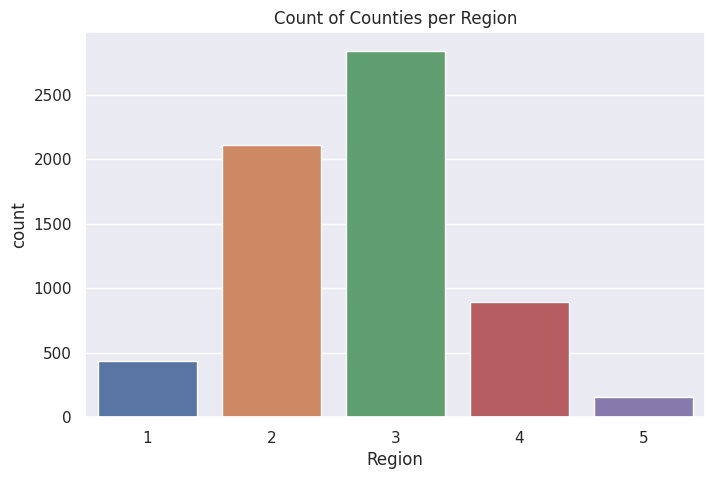

In [ ]:
sns.set(rc={'figure.figsize':(8,5)})
sns.countplot(data=census_df, x = 'Region').set(title = 'Count of Counties per Region')
plt.show()

Region 3 has the most counties. Plotting regions on a map will help determine what states and areas of the US are in each region.

In [ ]:
#Create functions for easier map plotting

#plot on counties
def plot_map(df,var_name,label):
  fig = px.choropleth_mapbox(df, geojson=counties, locations='CensusId', color=var_name,
                           color_continuous_scale='jet',
                           range_color=(0, max(df[var_name].values)),
                           mapbox_style="carto-positron",
                           zoom=2, center = {"lat": 37.966, "lon": -91.641},
                           opacity=0.5,
                           labels={var_name:label},
                           hover_name = df['County'],
                           animation_frame = 'Year')

  fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},width = 1000, height = 700)
  fig.show()

#plot heat map
def heat_map(df,var_name,label):
  fig = px.density_mapbox(df, lat='lat', lon='lng', z=var_name, radius=20,
                        zoom=2, center = {"lat": 37.0902, "lon": -95.7129},
                        opacity=0.5,
                        labels={var_name:label},
                        mapbox_style="stamen-terrain",
                        animation_frame = 'Year')
  fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},width = 1000,height = 700)
  fig.show()

In [ ]:
plot_map(census_df,'Region','Regions')
plt.show()

*   Region 1 is the Northeast
*   Region 2 is the Midwest
*   Region 3 is the South
*   Region 4 is the West
*   Region 5 is Puerto Rico


In [ ]:
#make dictionary of states and their regions
region_dict = {1:'Northeast',2:'Midwest',3:'South',4:'West',5:'Puerto Rico'}

census_df['Region_cat']= census_df['Region'].map(region_dict).astype('category')
df_2015['Region_cat']= df_2015['Region'].map(region_dict).astype('category')
df_2017['Region_cat']= df_2017['Region'].map(region_dict).astype('category')

In [ ]:
census_df.head()

,CensusId,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,...,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,lng,lat,Region,Year,Region_cat
0,01001,Alabama,Autauga,55221,26745,28476,2.6,75.8,18.5,0.4,...,73.6,20.9,5.5,0.0,7.6,-86.642900,32.535142,3,2015,South
1,01003,Alabama,Baldwin,195121,95314,99807,4.5,83.1,9.5,0.6,...,81.5,12.3,5.8,0.4,7.5,-87.722745,30.727825,3,2015,South
2,01005,Alabama,Barbour,26932,14497,12435,4.6,46.2,46.7,0.2,...,71.8,20.8,7.3,0.1,17.6,-85.391068,31.870090,3,2015,South
3,01007,Alabama,Bibb,22604,12073,10531,2.2,74.5,21.4,0.4,...,76.8,16.1,6.7,0.4,8.3,-87.126814,32.998376,3,2015,South
4,01009,Alabama,Blount,57710,28512,29198,8.6,87.9,1.5,0.3,...,82.0,13.5,4.2,0.4,7.7,-86.567006,33.980871,3,2015,South


EDA continues with looking at histograms of income data split by year.

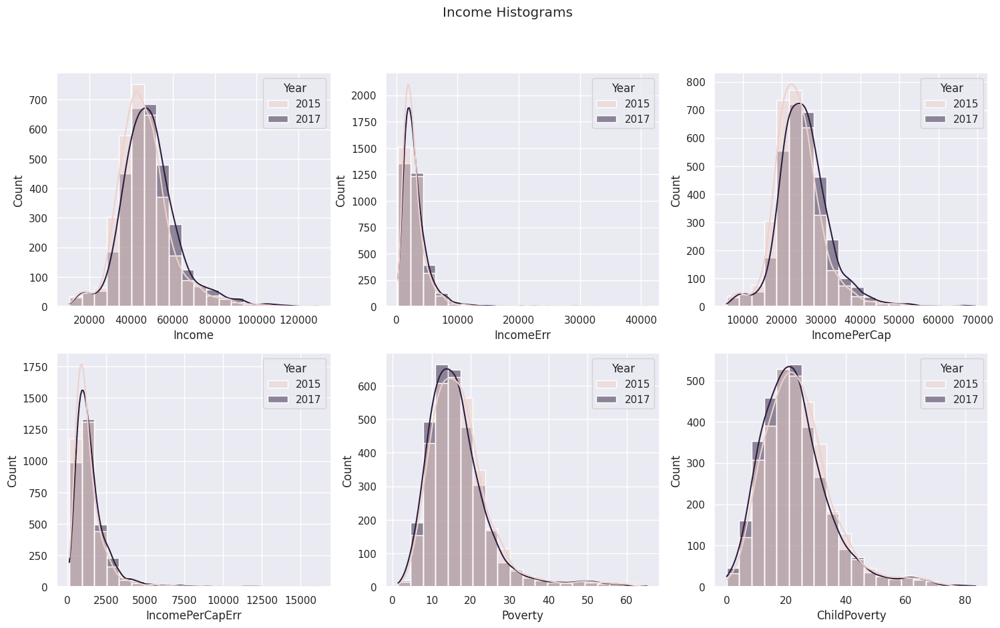

In [ ]:
#Histograms on Income Data
fig, axes = plt.subplots(2, 3, figsize=(18, 10))

fig.suptitle('Income Histograms')

step = 0
loc_r = 0
loc_c = 0

for var in income:
  ax = sns.histplot(ax=axes[loc_r, loc_c],data = census_df, x = var, hue = 'Year',bins = 20,
                    kde = True)
  #axes[loc_r, loc_c].set_title(var)
  #plt.tight_layout()
  #plt.title(var, fontsize = 20)
  #plt.show()
  step = step+1

  if(step <= 2):
    loc_r = 0
    loc_c = step
  else:
    loc_r= 1
    loc_c = step - 3


Both years have a left-skewed histogram for Income data. 2017 saw a slight increase and income and decrease in child poverty.

The next group of histograms plots various percentage sets in the data

In [ ]:
def multi_hist(vars,palette,label):
  for var in vars:
    color = palette[var]
    ax = sns.histplot(data = census_df, x = var, color = color,label = var,kde = True)
    plt.title(label,fontsize = 20)
    plt.xlabel('Percentage')
  ax.legend()
  plt.show()

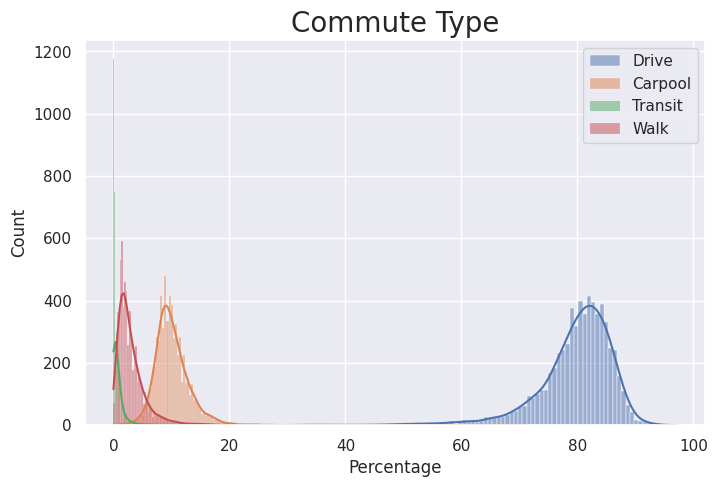

In [ ]:
palette ={"Drive": "C0", "Carpool": "C1", "Transit": "C2", "Walk": "C3"}
multi_hist(list(palette.keys()),palette,'Commute Type')
plt.show()

There is good separation of class for commuting data. The overwhelming majority of people drive to work.

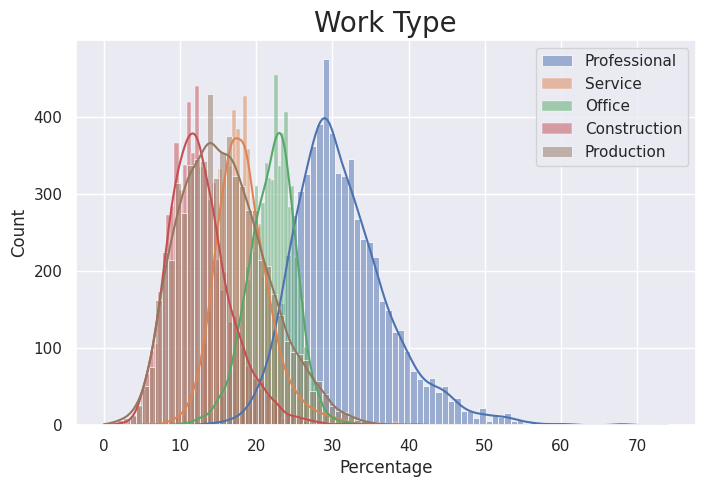

In [ ]:
palette ={"Professional": "C0", "Service": "C1", "Office": "C2", "Construction": "C3",'Production':'C5'}
multi_hist(list(palette.keys()),palette,'Work Type')
plt.show()

There is a good mix of work type in the US and one type does not overwhelm the others.

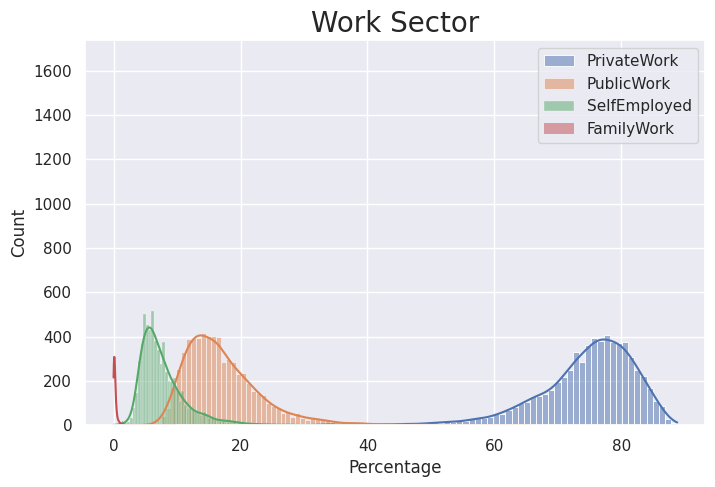

In [ ]:
palette ={"PrivateWork": "C0", "PublicWork": "C1", "SelfEmployed": "C2", "FamilyWork": "C3"}
multi_hist(list(palette.keys()),palette,'Work Sector')
plt.show()

The majority of Americans work in the Provate Sector. There are a few that are Family Work but not to teh same extent as the other classes.

To aid in futher visualizations a correlation plot was generated to see if there are any interesting relationships.

<ipython-input-40-97d1cc097c97>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



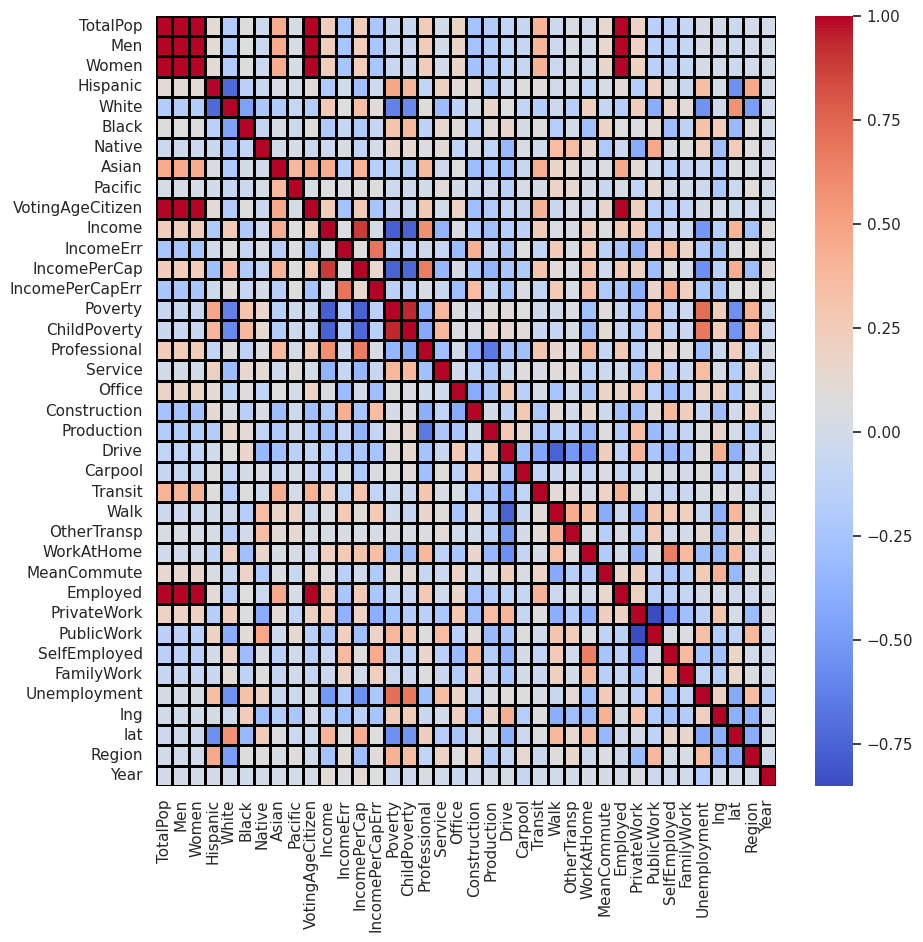

In [ ]:
sns.set(rc={'figure.figsize':(10,10)})
sns.heatmap(census_df.corr(),cmap = 'coolwarm',
            linewidths=1, linecolor='black')
plt.show()

The most intersting relation that I found was between longitude and mean commute. A vizualization of that relationship is in the next section.

##Vizualizations



**1) Combo Scatter/Heat Plot**

From the corr plot I selected two variables that were not strongly correlated to eacher in hopes of achieving a good contour heat plot. I selected 'Proffesional' and 'MeanCommute' I would have expected that there was a stronger relation between the two as professionsal work more in cities and need to commute from further away.

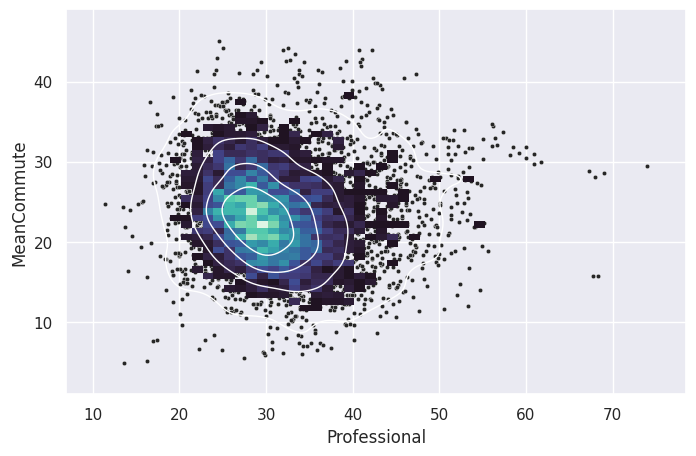

In [ ]:
f, ax = plt.subplots()
sns.scatterplot(data=census_df, x = 'Professional', y = 'MeanCommute',
                s = 10, color = '.15')
sns.histplot(data=census_df, x = 'Professional', y = 'MeanCommute',
             bins=50, pthresh=.1, cmap="mako")
sns.kdeplot(data=census_df, x = 'Professional', y = 'MeanCommute',
            levels=5, color="w", linewidths=1)
plt.show()

Instead the percentage of professionals and Mean Commute concentrate towards their averages in the plot above. There are outliers in every direction but skewed more towards a higher commute time versus higher professional percentage.

**2) Race in New England**

There is a positive relation between the latitude of the county and the percentage of white living there. But what about minorities? How well represented are they in these regions. I decided to plot strip charts of each minority for each state in New England against each other. The bold diamond and bars on the strip chart are the mean and upper/lower quartiles.

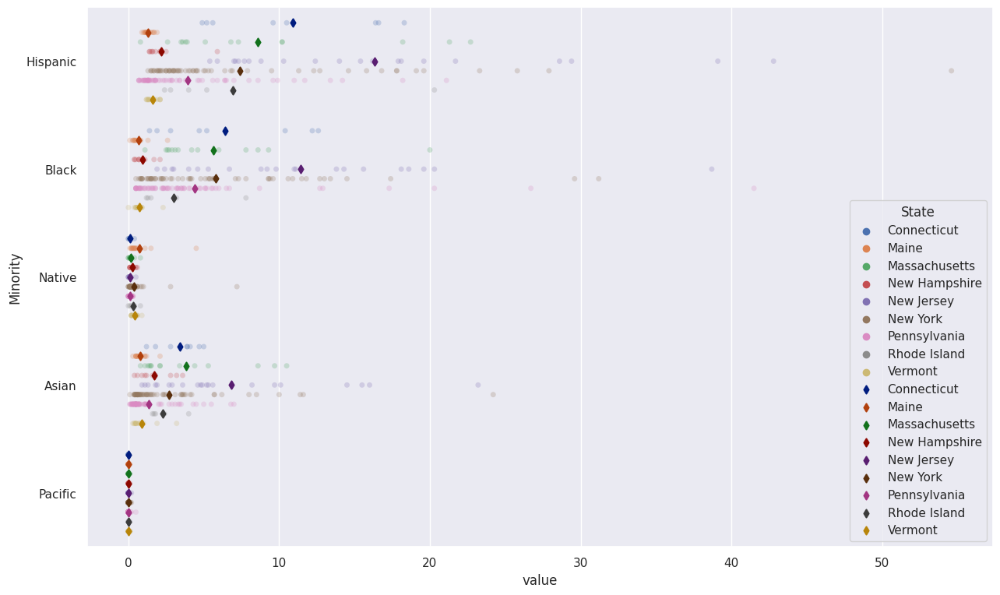

In [ ]:
minor = ['State','Hispanic', 'Black', 'Native', 'Asian','Pacific']

#subset census_df and melt
df = census_df[(census_df['Region']==1) & ~(census_df['Year']==2017)]
df = df[minor]
df = pd.melt(df, "State", var_name="Minority")

# Initialize the figure
f, ax = plt.subplots()
f.set_figheight(9)
f.set_figwidth(15)
#sns.despine(bottom=True, left=True)

# Show each observation with a scatterplot
sns.stripplot(
    data=df, x="value", y="Minority", hue="State",
    dodge=True, alpha=.25, zorder=1,jitter = False)

# Show the conditional means, aligning each pointplot in the
# center of the strips by adjusting the width allotted to each
# category (.8 by default) by the number of hue levels
sns.pointplot(
    data=df, x="value", y="Minority", hue="State",
    join=False, dodge=.8 - .8 / 9, palette="dark",
    markers="d", scale=.75, errorbar=None)

plt.show()


As expected, Pacific Islanders are not represented as Hawaii/ the Pacific Ocean is on the other side of the country. Hispanics are the majority for every New England state except for Pennsylvania where Blacks are.

**3) Unemployment Rate in The US**

The news always talks about unemployment rate as a way to show a healthy economy. Using the method created to plot regions on the map, unemployment rate is shown per county and can the year can be adjusted at the bottom of the map.

In [ ]:
plot_map(census_df,'Unemployment','Unemployment Rate')
plt.show()

Unemployment rate dropped in 2017 with higher rates in the South and Mid West.

**4) Joint Grid of Longitude and Mean Commute**

For the intersted realtion that I saw in the correlation plot, I plotted a heat map of Longitude vs Mean Commute and added a histogram of the two variables on their axes.

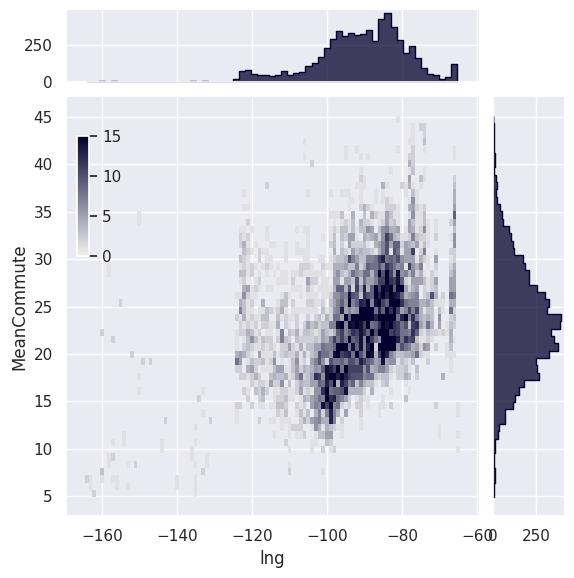

In [ ]:
g = sns.JointGrid(data = census_df, x = 'lng', y = 'MeanCommute',
                  marginal_ticks=True)

# Create an inset legend for the histogram colorbar
cax = g.figure.add_axes([.15, .55, .02, .2])

# Add the joint and marginal histogram plots
g.plot_joint(
    sns.histplot, discrete=(True, False),
    cmap="light:#03012d", pmax=.8, cbar=True, cbar_ax=cax
)
g.plot_marginals(sns.histplot, element="step", color="#03012d")
plt.show()

As Longitude increases (More East), Mean Commute time increases. This may be due to the cities being older and not built/planned for highways and ease of driving (ex. Boston).

**5) Percent Work from Home and Income**

Another interesting relation I found was increasing income with increasing work from home percentage. This data was beofer COVID so is not skewed by the mass movement to WFH culture. Before then a lot of workers in the Computer Science field were already working from home and tend to earn larger amounts.

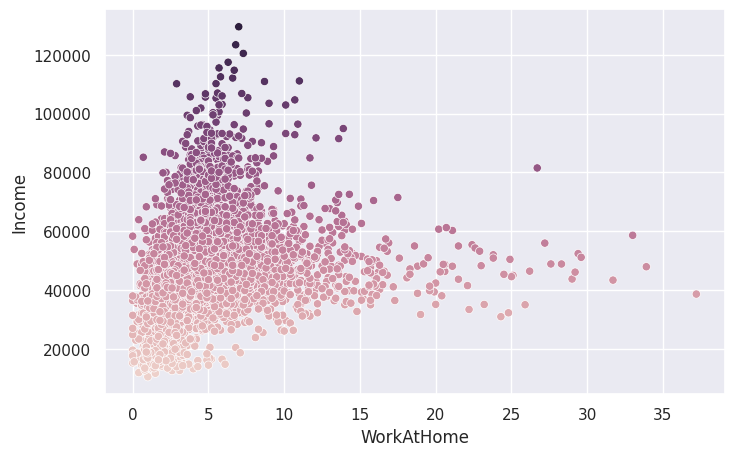

In [ ]:
sns.scatterplot(data = census_df, x = 'WorkAtHome', y = 'Income', hue = 'Income',
                legend = False)
plt.show()

##Surprises



I was surprised to find that there is a correlation between the region of the county and certain predictors. For example, the relations between Region and the amount of child poverty or percentage of citizens working in the public sector.

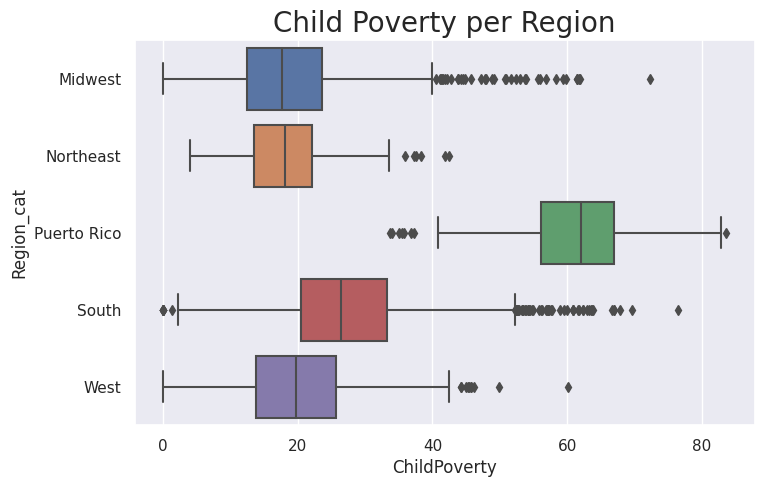

In [ ]:
sns.boxplot(data = census_df, x = 'ChildPoverty',y='Region_cat')
plt.title('Child Poverty per Region', fontsize = 20)
plt.show()

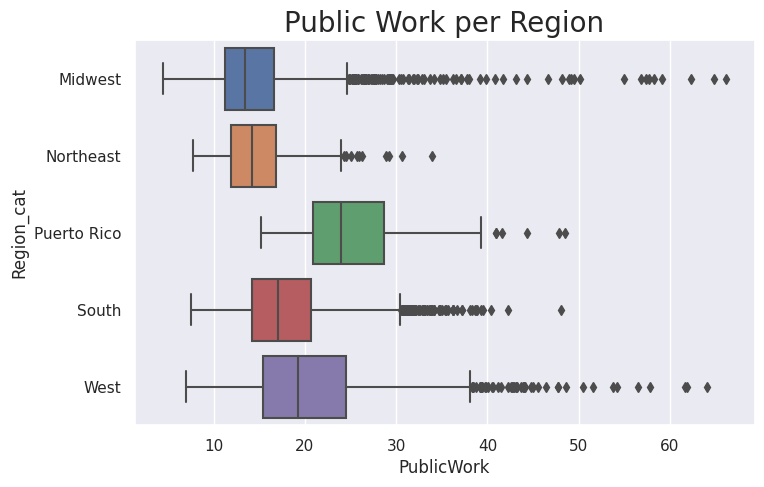

In [ ]:
sns.boxplot(data = census_df, x = 'PublicWork',y='Region_cat')
plt.title('Public Work per Region', fontsize = 20)
plt.show()

Relations from the correlation plot on Regions is not accurate as the numbered region is all based on the order of the class and is not quantitative. However there are some regions that do have higher rates or values for some variables.

Another surprise that I had when sorting through the data is correlation between certain variables and longitude or latitude. As a vizualization I plotted Mean Commute and Longitude but there are others such as Income and Latitude.

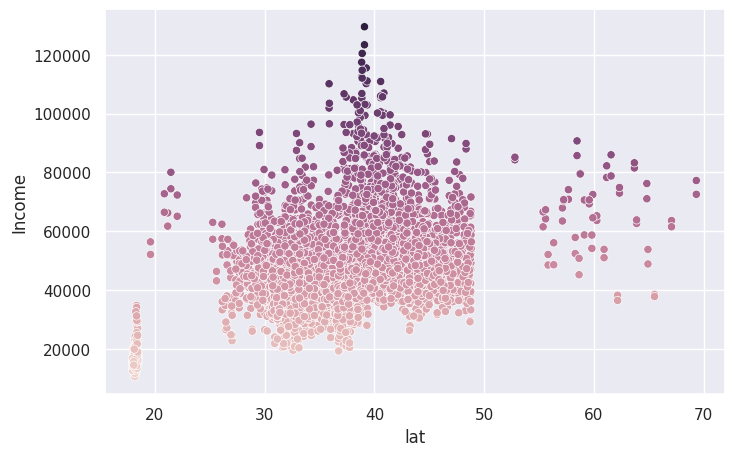

In [ ]:
sns.scatterplot(data = census_df, x = 'lat', y = 'Income', hue = 'Income',
                legend = False)

plt.show()

Puerto Rico and Alaska are outliers to the data but there is still a trend without them. Somthing to consider when moving to data analysis is outliers when it comes to geographical location.

#Model Revision

My inital project topic was to look at predciting if a county was at risk of increasing poverty. This classifcation was created by using a delta between 2017 and 2015 poverty rates to create a risk class for rising poverty. Upon further investigation, poverty risk was difficult to predict as there was no correlation to the class and the predictors in the model. The initial steps taken in this topic are below.

In [ ]:
#Generate new classifier of poverty risk
df_2017['Poverty Change'] = df_2017['Poverty'] - df_2015['Poverty']


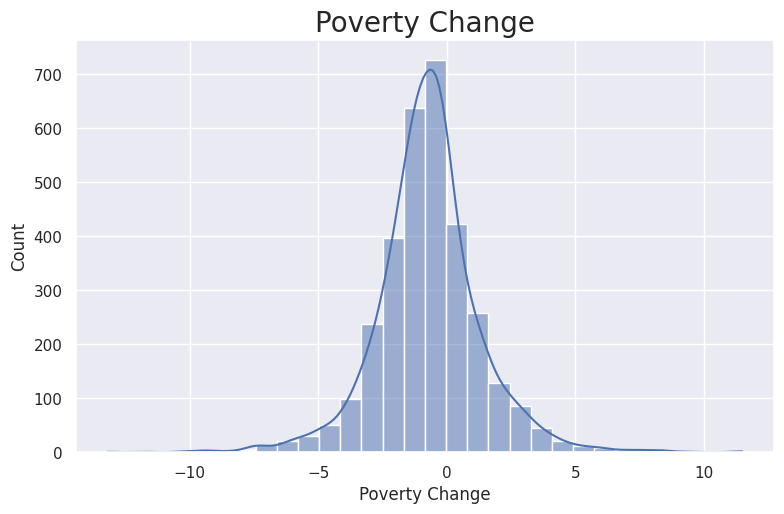

In [ ]:
 #plot distribution of poverty change
ax = sns.histplot(data = df_2017, x = 'Poverty Change',bins = 30,
                  kde = True)
plt.tight_layout()
plt.title('Poverty Change', fontsize = 20)
plt.show()

<ipython-input-98-d6749a1690b3>:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



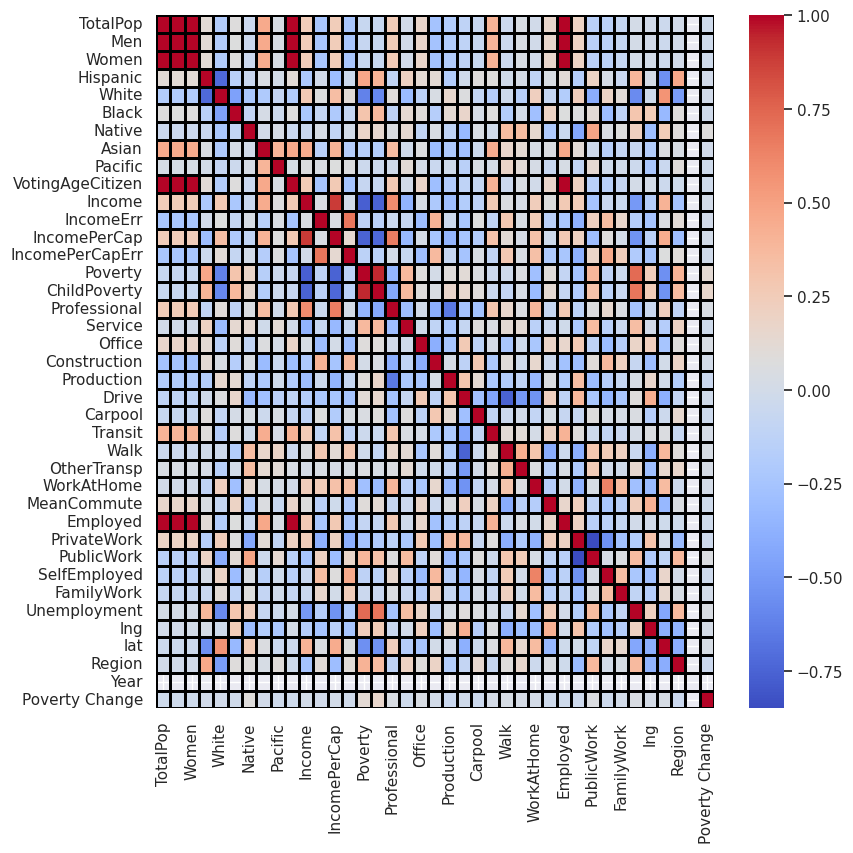

In [ ]:
sns.set(rc={'figure.figsize':(9,9)})
sns.heatmap(df_2017.corr(),cmap = 'coolwarm',
            linewidths=1, linecolor='black')
plt.show()

The correlation plot shows that there is no strong positive or negative correlations between poverty change and the other predictors. Some classification algorithms were created but all attempts, including random forests and neural networks, ended up predicting the same class or all samples which resulted in the highest mean precision and recall. For these reasons, i pivoted my research to focus on mean commute time.

For creating the X and y dataframes for the regressions, both 2015 and 2017 data was used to increase the amount of samples to pass to the models.

In [ ]:
#Create X and y dataframes
df = census_df.drop(labels = ['Region'], axis = 1)

df.set_index(['CensusId','State','County','Year'],drop = True,inplace=True)

X = df.drop(labels = ['MeanCommute'], axis = 1)
X = pd.get_dummies(X,prefix = ['Region'],columns = ['Region_cat'])
y = df['MeanCommute']

X.head()

,,,,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,VotingAgeCitizen,...,SelfEmployed,FamilyWork,Unemployment,lng,lat,Region_Midwest,Region_Northeast,Region_Puerto Rico,Region_South,Region_West
CensusId,State,County,Year,,,,,,,,,,,,,,,,,,,,,
01001,Alabama,Autauga,2015,55221,26745,28476,2.6,75.8,18.5,0.4,1.0,0.0,40725,...,5.5,0.0,7.6,-86.642900,32.535142,0,0,0,1,0
01003,Alabama,Baldwin,2015,195121,95314,99807,4.5,83.1,9.5,0.6,0.7,0.0,147695,...,5.8,0.4,7.5,-87.722745,30.727825,0,0,0,1,0
01005,Alabama,Barbour,2015,26932,14497,12435,4.6,46.2,46.7,0.2,0.4,0.0,20714,...,7.3,0.1,17.6,-85.391068,31.870090,0,0,0,1,0
01007,Alabama,Bibb,2015,22604,12073,10531,2.2,74.5,21.4,0.4,0.1,0.0,17495,...,6.7,0.4,8.3,-87.126814,32.998376,0,0,0,1,0
01009,Alabama,Blount,2015,57710,28512,29198,8.6,87.9,1.5,0.3,0.1,0.0,42345,...,4.2,0.4,7.7,-86.567006,33.980871,0,0,0,1,0


A 80/20 test train split was used. Currently there are 40 variables in the dataset. To reduce the amount of variables, a principal component analysis was run and the results plotted to see how many principa components it takes to get up to 80% explained variance of the data. Before passing the data to PCA, the values were standardized and scaled to reduce the effect of the magnitudes on the results.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import explained_variance_score,max_error,r2_score,mean_squared_error,make_scorer

#split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


#Standardize and scale the data
scaler = StandardScaler()
X_train_scale = scaler.fit_transform(X_train)

#Run PCA with 15 components and plot
pca = PCA(n_components=15)
df_pca = pca.fit(X_train_scale, y = y_train)

exp_var_pca = pca.explained_variance_ratio_

cum_sum_eigenvalues = np.cumsum(exp_var_pca)

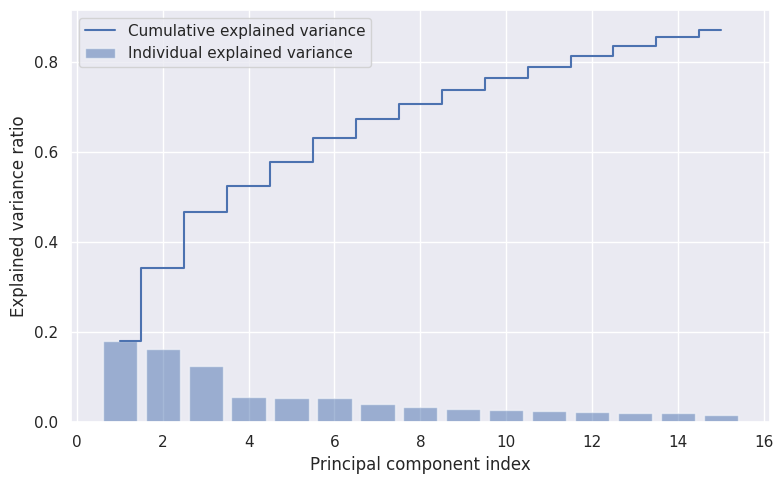

In [ ]:
sns.set(rc={'figure.figsize':(8,5)})
plt.bar(range(1,len(exp_var_pca)+1), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(1,len(cum_sum_eigenvalues)+1), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

12 Principal Components explain over 80% of the variance in the data. The training and test sets were transformed and a decision tree regression was creatd for a quick check of the validity of the model.

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn import metrics

#fit/transform PCA
pca = PCA(n_components=12)
pc_train = scaler.fit_transform(X_train)
pc_train = pca.fit_transform(pc_train)
pc_train = pd.DataFrame(pc_train)
pc_train.columns = pc_train.columns.astype(str)

pc_test = scaler.transform(X_test)
pc_test = pca.transform(pc_test)
pc_test = pd.DataFrame(pc_test)
pc_test.columns = pc_test.columns.astype(str)

#run DecsionTreeRegressor
clf_dt = DecisionTreeRegressor(max_depth=10)

clf_dt.fit(pc_train,y_train)
y_pred_train = clf_dt.predict(pc_train)
y_pred_test = clf_dt.predict(pc_test)

print('train R^2: ',f'{clf_dt.score(pc_train, y_train):.3f}')
print('test R^2: ',f'{clf_dt.score(pc_test, y_test):.3f}')


print('train MSE: ',f'{mean_squared_error(y_train, y_pred_train):.3f}')
print('test MSE: ',f'{mean_squared_error(y_test, y_pred_test):.3f}')

train R^2:  0.678
test R^2:  0.319
train MSE:  10.322
test MSE:  21.134


There was a good fit on the training model but resuling predictions on the test set did not show a strong correlation and high MSE. The next model to run was a Random Forest Regressor to increase the accuracy of the model. Initial hyperparameters were chosed by a few iterations manually.

In [ ]:
#Run RandomForestRegressor
from sklearn.ensemble import RandomForestRegressor

clf_rf = RandomForestRegressor(
            n_estimators=200,
            max_depth = 15,
            max_features = 6,
            n_jobs = -1)

clf_rf.fit(pc_train, y_train)

y_pred_train = clf_rf.predict(pc_train)
y_pred_test = clf_rf.predict(pc_test)

print('train R^2: ',f'{clf_rf.score(pc_train, y_train):.3f}')
print('test R^2: ',f'{clf_rf.score(pc_test, y_test):.3f}')


print('train MSE: ',f'{mean_squared_error(y_train, y_pred_train):.3f}')
print('test MSE: ',f'{mean_squared_error(y_test, y_pred_test):.3f}')


train R^2:  0.899
test R^2:  0.586
train MSE:  3.246
test MSE:  12.841


This model increased the fit for both the trainign and test sets. The training set fit versus test set fit shows that there may be some overfitting in the regressor. Stratified K-Fold cross validation was implemented to reduce the risk of overfitting while maintaining the ratio of the classes. Grid Search cross validation was run at the same time to test various combinations of hyperparameters for the Random Forest Regressor. The R-Squared value will be used to refit and return the best estimator.

In [ ]:
#introduce Cross validation
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV, KFold, StratifiedKFold

In [ ]:
#hyperparameter grid
param_grid = {
    'min_samples_split': [3, 5, 10],
    'n_estimators' : [100,150,200],
    'max_depth': [10,15,30],
    'max_features': [.25,.5,.75]
}

#Scores to assess best model
scorer = {
    'rsquared':make_scorer(r2_score),
    'MSE': make_scorer(mean_squared_error)
}

#Cross validation of dataset
kf = KFold(n_splits=3)

clf_rf_cv = RandomForestRegressor(n_jobs = 1)

GridCV = GridSearchCV(clf_rf_cv,param_grid,scoring = scorer,
                           refit = 'rsquared',cv=kf, n_jobs=1)

In [ ]:
GridCV.fit(pc_train, y_train)

GridSearchCV(cv=KFold(n_splits=3, random_state=None, shuffle=False),
             estimator=RandomForestRegressor(n_jobs=1), n_jobs=1,
             param_grid={'max_depth': [10, 15, 30],
                         'max_features': [0.25, 0.5, 0.75],
                         'min_samples_split': [3, 5, 10],
                         'n_estimators': [100, 150, 200]},
             refit='rsquared',
             scoring={'MSE': make_scorer(mean_squared_error),
                      'rsquared': make_scorer(r2_score)})

In [ ]:
print("Best R^2 (CV score=%0.3f):" % GridCV.best_score_)
print(GridCV.best_params_)

Best R^2 (CV score=0.518):
{'max_depth': 30, 'max_features': 0.5, 'min_samples_split': 3, 'n_estimators': 200}


In [ ]:
'''
Best R^2 (CV score=0.518):
{'max_depth': 30, 'max_features': 0.5, 'min_samples_split': 3, 'n_estimators': 200}
'''

The best model that the Grid Search found were larger trees looking at half the amount of variables for each tree. Histogram for the r-squared mean values were plotted to compare all the model performances from cross validation. A correlation plot was also created to visually determine the impact of each parameter on model performance.

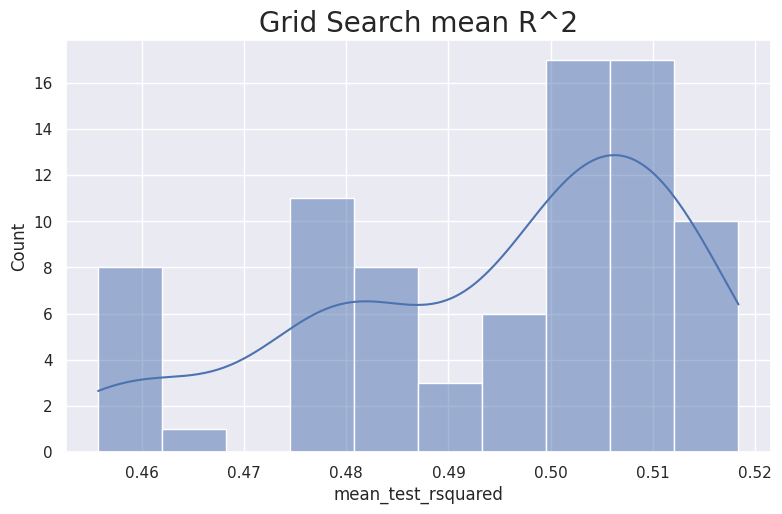

"\nax = sns.histplot(data = df_Grid_result, x = 'mean_test_MSE',bins = 10,\n                  kde = True)\nplt.tight_layout()\nplt.title('Grid Search mean MSE', fontsize = 20)\nplt.show()\n"

In [ ]:
#Histogram of mean MSE and rsquared
sns.set(rc={'figure.figsize':(8,5)})
df_Grid_result = pd.DataFrame(GridCV.cv_results_)
ax = sns.histplot(data = df_Grid_result, x = 'mean_test_rsquared',bins = 10,
                  kde = True)
plt.tight_layout()
plt.title('Grid Search mean R^2', fontsize = 20)
plt.show()
'''
ax = sns.histplot(data = df_Grid_result, x = 'mean_test_MSE',bins = 10,
                  kde = True)
plt.tight_layout()
plt.title('Grid Search mean MSE', fontsize = 20)
plt.show()
'''

The majority of the models had more than 50% of the variance explained. The best fit model from the Grid Search was not an outlier in performance and is comparable for many of the models tested. This shows that the hyperparameters tested and their ranges had marginal impact on model performance.

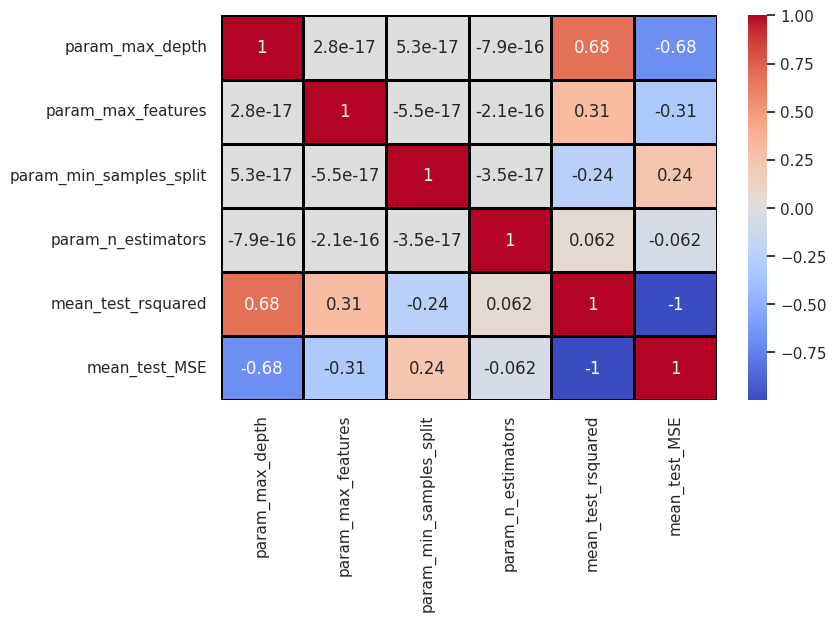

In [ ]:
#build correlation plot
grid_corr = ['param_max_depth','param_max_features','param_min_samples_split','param_n_estimators','mean_test_rsquared','mean_test_MSE']

sns.heatmap(df_Grid_result[grid_corr].astype(float).corr(),cmap = 'coolwarm',
            linewidths=1, linecolor='black',annot = True)
plt.show()

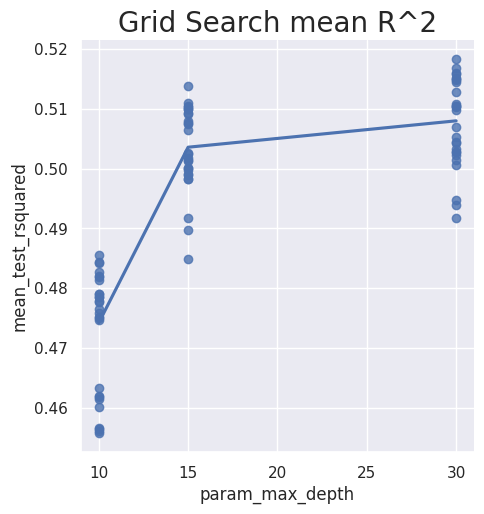

In [ ]:
#scatterplot
#ax = sns.scatterplot(data = df_Grid_result, x = 'param_max_depth',y = 'mean_test_rsquared')
sns.set(rc={'figure.figsize':(8,5)})
ax = sns.lmplot(data = df_Grid_result[grid_corr].astype(float),
                x = 'param_max_depth',y = 'mean_test_rsquared',
                lowess = True, ci=None)
plt.tight_layout()
plt.title('Grid Search mean R^2', fontsize = 20)
plt.show()

The max depth of the trees had the greatest impact in increasign r-squared which is inversly proportional to MSE. However, increasing the depth from 15 to 30 had little effect on the performance of the model. Increasing the max amount of features also improved model performance. Number of trees (estimators) had little impact and increasing the min sample split made the prediction model worse. Last was to check the performance of the best fit model.

In [ ]:
y_pred_train = GridCV.predict(pc_train)
y_pred_test = GridCV.predict(pc_test)

print('train R^2: ',f'{GridCV.score(pc_train, y_train):.3f}')
print('test R^2: ',f'{GridCV.score(pc_test, y_test):.3f}')


print('train MSE: ',f'{mean_squared_error(y_train, y_pred_train):.3f}')
print('test MSE: ',f'{mean_squared_error(y_test, y_pred_test):.3f}')

train R^2:  0.933
test R^2:  0.591
train MSE:  2.150
test MSE:  12.681


Even with cross validation, the model is still overfitting to the training data. The validation set that was not included in the model training did perform better than the test sets from the Grid Search.

The final model that was created was a Sequential Neural Network. The number of variables in the hidden layers is half of the previous step. Rectified Linear Unit was used as the activation function.

In [ ]:
#!pip install tensorflow_addons

In [ ]:
#!pip install scikeras

In [ ]:
# Sequential Neural Network
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from scikeras.wrappers import KerasRegressor
from tensorflow.keras import metrics
from tensorflow_addons.metrics import RSquare

X_nn = pc_train.values.astype(np.float32)
y_nn = y_train.astype(np.float32)

X_test_nn = pc_test.values.astype(np.float32)
y_test_nn = y_test.astype(np.float32)

# define the keras model
model = Sequential()
model.add(Dense(12, input_shape=(12,), activation='relu'))
model.add(Dense(6, activation='relu'))
model.add(Dense(3, activation='relu'))
model.add(Dense(1, activation='linear'))
# compile the keras model
model.compile(loss='mse', optimizer='adam',metrics=[RSquare()])
estimator = KerasRegressor(model=model, epochs=25, batch_size=5)
# fit the keras model on the dataset
kf_5 = KFold(n_splits = 5)
#results = cross_val_score(estimator,X_nn,y_nn, cv = kf_5, scoring = 'neg_mean_squared_error')
# evaluate the keras model
#print("Baseline: %.2f (%.2f) MSE" % (results.mean(), results.std()))

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning:



TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 




In [ ]:
model.fit(X_nn, y_nn, epochs=50, batch_size=10,verbose = 0)

In [ ]:
y_pred_train = model.predict(X_nn)
y_pred_test = model.predict(X_test_nn)


print('train R^2: ',f'{r2_score(y_train, y_pred_train):.3f}')
print('test R^2: ',f'{r2_score(y_test, y_pred_test):.3f}')

print('train MSE: ',f'{mean_squared_error(y_train, y_pred_train):.3f}')
print('test MSE: ',f'{mean_squared_error(y_test, y_pred_test):.3f}')

41/41 [==============================] - 0s 2ms/step
train R^2:  0.540
test R^2:  0.534
train MSE:  14.757
test MSE:  14.449


The Sequential Neural Network resulted in training and test results with similar R-Squared and MSE, reducing the overfitting seen in the random forest cross validation. It did however result in similar test MSE.

#Final Analysis


##1) Covid in Worceser County

*Covid just started, 75% of the private sector moves to work at home. In Worcester County, does the mean commute time reduce by more than 20 min?*

Using the data from 2017, 75% of the private sector percentage was subracted to 'Drive' and added to 'Work From Home' The variables were transformed and mean commute was predicted using the three classifiers.

In [ ]:
#2017 mean commute
y_2017 = y.loc[:,'Massachusetts','Worcester County',2017]

#adjust Drive and Work From Home
Q1 = X.loc[:,'Massachusetts','Worcester County',2017]
Q1_private = Q1['PrivateWork']*0.75
Q1['PrivateWork'] = Q1['PrivateWork']*0.25
Q1['Drive'] = Q1['Drive'] - Q1_private
Q1['WorkAtHome'] = Q1['WorkAtHome'] + Q1_private
Q1['Unemployment'] = 13

#fittransform
Q1 = scaler.transform(Q1)
Q1 = pca.transform(Q1)
Q1 = pd.DataFrame(Q1)
Q1.columns = Q1.columns.astype(str)

Q1_DTR = clf_dt.predict(Q1)[0]
Q1_GCV = GridCV.predict(Q1)[0]
Q1_SNN = model.predict(Q1.values.astype(np.float32))[0][0]

In [ ]:
print('2017 Worcester Commute: ',f'{y_2017.values[0]:.3f}')
print('DTR Covid Commute: ',f'{Q1_DTR:.3f}')
print('GCV RFR Covid Commute: ',f'{Q1_GCV:.3f}')
print('SNN Covid Commute: ',f'{Q1_SNN:.3f}')

2017 Worcester Commute:  28.700
DTR Covid Commute:  27.833
GCV RFR Covid Commute:  24.693
SNN Covid Commute:  18.051


The low R-Square and high MSE of the Decision Tree Regressor is shown here as the predicted value is the same as the initial 2017 Value. Both the random forest and sequential network predicted a decrease in the mean commute time. The reduction in commute time is less than I expected initally. The small reduction may be due to the low amount of the population that works in Worcester also lives in Worcester Country. With Boston relatively close to Worcester, much of the population may commute furhter away to a larger city.

##2) Population Boom in Maricopa County

In [ ]:
#2017 mean commute
y_2017_Q2 = y.loc[:,'Arizona','Maricopa County',2017]

#Add 10% pop to Maricopa
Q2 = X.loc[:,'Arizona','Maricopa County',2017]
Q2['Men'] = Q2['Men']*1.1
Q2['Women'] = Q2['Women']*1.1
Q2['TotalPop'] = Q2['TotalPop']*1.1

#fittransform
Q2 = scaler.transform(Q2)
Q2 = pca.transform(Q2)
Q2 = pd.DataFrame(Q2)
Q2.columns = Q2.columns.astype(str)

Q2_DTR = clf_dt.predict(Q2)[0]
Q2_GCV = GridCV.predict(Q2)[0]
Q2_SNN = model.predict(Q2.values.astype(np.float32))[0][0]

In [ ]:
print('2017 Maricopa Commute: ',f'{y_2017_Q2.values[0]:.3f}')
print('DTR Pop Inc. Commute: ',f'{Q2_DTR:.3f}')
print('GCV RFR Pop Inc. Commute: ',f'{Q2_GCV:.3f}')
print('SNN Pop Inc. Commute: ',f'{Q2_SNN:.3f}')

2017 Maricopa Commute:  25.800
DTR Pop Inc. Commute:  25.243
GCV RFR Pop Inc. Commute:  27.334
SNN Pop Inc. Commute:  23.882


Again, the high MSE of the Decision Tree Regressor is clear as it predicted a decrease in commute time with an increase in population. The Sequential network also predicted a shorter commute time. The correlation plot at the beginning of the report did show little correlation between these variables and the predictor.

#Conclusion

Three regression techniques were tested for their performance in predicting the mean commute time. Decision Tree Regression was the first model created to test the vailidity of the research question with a quick turnaround. A Random Forest Regression was then made to increase accuracy and vaidate with cross-validation and performing a grid search to rune hyperparamters. The last model was a Sequential Neural network with three hidden layers using ReLu as the activation function. All three models were assessed after the data was cleaned, merged, imputed, and transformed using Principal Component Analysis.

Overfitting of the models and low explained variane are the two areas that need improvement in futher iterations. Other regression techniques can be tested such as K-Nearest Neighbors. Expanding the dataset to use individual citizen information versus county averages could increase performance as well, but the tradeoff is loss of the macro county results. Another option is to change the prediction model into a classification problem of if the commute wil increase, decrease, or remain constant, creating the classes using the delta between 2015 and 2017.